In [1]:
import scipy
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import seaborn.objects as so

from ete3 import TreeStyle, Tree, TextFace, add_face_to_node

sc.set_figure_params(dpi=300, scanpy=True)
sc.settings.verbosity = 3
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
import os
# change it according to your preferences
DATA_DIR = "/n/groups/kirschner/xenopus/old_atlas"
NF_stage = "S12"
# adata_kotov_fp = os.path.join(DATA_DIR, "GSE198491_matrix.h5ad")
# adata_train_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.kNN.h5ad")
# adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.h5ad")
adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")


os.environ['QT_QPA_PLATFORM']='offscreen'

In [3]:
import sys
sys.path.append("/home/ksp503/projs/xenopus/notebooks")

from little import *

In [4]:
# adata.uns['log1p']["base"] = None

# DE marker gene determination for Briggs cell types

In [4]:
adata = sc.read_h5ad(adata_fp)
adata.var

,gene_name,human_id,human_name,human_desc,eval_forward,eval_backward,mt,ribo,n_cells_by_counts,mean_counts,...,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches,residual_variances,highly_variable_intersection,gene_id,gene_name_display
XBXT10g000001,nsfl1c,sp|Q9UNZ2|NSF1C_HUMAN,NSFL1C,NSFL1 cofactor p47,4.900000e-171,6.200000e-171,False,False,2120,0.018720,...,True,2450.0,0.022420,0.026321,0.918688,3,1.398828,False,XBXT10g000001,XBXT10g000001|nsfl1c|NSFL1C
XBXT10g000002,clul1,sp|Q15846|CLUL1_HUMAN,CLUL1,Clusterin-like protein 1,1.300000e-65,1.300000e-65,False,False,74,0.000627,...,False,NaN,0.000781,0.000824,0.966316,0,0.807312,False,XBXT10g000002,XBXT10g000002|clul1|CLUL1
XBXT10g000003,vwc2l,sp|B2RUY7|VWC2L_HUMAN,VWC2L,von Willebrand factor C domain-containing prot...,1.000000e-125,1.100000e-125,False,False,122,0.001010,...,False,NaN,0.001269,0.001333,0.920083,0,0.877433,False,XBXT10g000003,XBXT10g000003|vwc2l|VWC2L
XBXT10g000004,slc47a1,sp|Q96FL8|S47A1_HUMAN,SLC47A1,Multidrug and toxin extrusion protein 1,2.400000e-156,NaN,False,False,102,0.000831,...,False,NaN,0.001085,0.001084,0.898303,0,0.914773,False,XBXT10g000004,XBXT10g000004|slc47a1|SLC47A1
XBXT10g000005,ikbkg,sp|Q9Y6K9|NEMO_HUMAN,IKBKG,NF-kappa-B essential modulator,3.100000e-84,4.300000e-83,False,False,1404,0.013506,...,False,NaN,0.017474,0.024024,0.947249,0,0.902910,False,XBXT10g000005,XBXT10g000005|ikbkg|IKBKG
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
XBXT10g029565,LOC116412448,NaN,NaN,NaN,NaN,NaN,False,False,69,0.000668,...,False,NaN,0.000857,0.001203,1.174214,0,0.873148,False,XBXT10g029565,XBXT10g029565|LOC116412448
XBXT10g029569,LOC105945488,NaN,NaN,NaN,NaN,NaN,False,False,27,0.000220,...,False,NaN,0.000271,0.000271,0.799397,0,0.711168,False,XBXT10g029569,XBXT10g029569|LOC105945488
XBXT10g029570,crygdl.43,sp|P07316|CRGB_HUMAN,CRYGB,Gamma-crystallin B,1.100000e-66,NaN,False,False,7,0.000057,...,False,NaN,0.000076,0.000076,0.652872,0,0.223241,False,XBXT10g029570,XBXT10g029570|crygdl.43|CRYGB
XBXT10g029572,trnae-cuc,NaN,NaN,NaN,NaN,NaN,False,False,3,0.000024,...,False,NaN,0.000033,0.000033,0.500032,0,0.121039,False,XBXT10g029572,XBXT10g029572|trnae-cuc


In [6]:
REF_DIR = "/n/groups/kirschner/xenopus/reference/Xentr10.0"

gtf_ids = pd.read_csv(os.path.join(REF_DIR, "XENTR_10.0_Xenbase.names.tsv"), sep="\t")
gtf_ids[["eval_forward", "eval_backward"]] = gtf_ids[["eval_forward", "eval_backward"]].astype(float)
gtf_ids_unique = gtf_ids.sort_values("eval_forward").drop_duplicates("gene_id")
cols = ["gene_name", "human_id", "human_name", "human_desc", "eval_forward", "eval_backward"]
adata.var[cols] = gtf_ids_unique.set_index("gene_id").loc[adata.var_names, cols].values
adata.var[["eval_forward", "eval_backward"]] = adata.var[["eval_forward", "eval_backward"]].astype(float)

In [7]:
# gtf = pd.read_csv(os.path.join(REF_DIR, "XENTR_10.0_Xenbase.sorted.gtf"), sep="\t", header=None)
# gtf["gene_id"] = gtf.iloc[:, 8].str.extract('gene_id "(\w+)"')
# gtf["gene_name"] = gtf.iloc[:, 8].str.extract('gene_name "(\w+)"')
# gtf

,0,1,2,3,4,5,6,7,8,gene_id,gene_name
0,Chr1,Xenbase,transcript,43856,87766,.,+,.,"transcript_id ""mRNA016866""; gene_id ""XBXT10g00...",XBXT10g003319,LOC101732307
1,Chr1,Xenbase,exon,43856,43947,.,+,.,"transcript_id ""mRNA016866""; gene_id ""XBXT10g00...",XBXT10g003319,LOC101732307
2,Chr1,Xenbase,CDS,43895,43947,.,+,0,"transcript_id ""mRNA016866""; gene_id ""XBXT10g00...",XBXT10g003319,LOC101732307
3,Chr1,Xenbase,exon,48839,49001,.,+,.,"transcript_id ""mRNA016866""; gene_id ""XBXT10g00...",XBXT10g003319,LOC101732307
4,Chr1,Xenbase,CDS,48839,49001,.,+,1,"transcript_id ""mRNA016866""; gene_id ""XBXT10g00...",XBXT10g003319,LOC101732307
...,...,...,...,...,...,...,...,...,...,...,...
1291829,MT,Xenbase,CDS,11859,13676,.,+,0,"transcript_id ""XBXT10g025955""; gene_name ""ND5"";",NaN,ND5
1291830,MT,Xenbase,transcript,13668,14186,.,-,.,"transcript_id ""XBXT10g022652""; gene_id ""XBXT10...",XBXT10g022652,ND6
1291831,MT,Xenbase,CDS,13668,14186,.,-,0,"transcript_id ""XBXT10g022652""; gene_name ""ND6"";",NaN,ND6
1291832,MT,Xenbase,transcript,14258,15399,.,+,.,"transcript_id ""XBXT10g024478""; gene_id ""XBXT10...",XBXT10g024478,CYTB


In [7]:
adata.var.columns

Index(['gene_name', 'human_id', 'human_name', 'human_desc', 'eval_forward',
       'eval_backward', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts',
       'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts',
       'log1p_total_counts', 'n_cells', 'highly_variable',
       'highly_variable_rank', 'means', 'variances', 'variances_norm',
       'highly_variable_nbatches'],
      dtype='object')

In [7]:
adata.raw = adata.copy()

In [15]:
unlabeled = "Unlabeled"

reannotate_dict = {
    "germ cell": unlabeled,
    "Unknown": unlabeled,
    "Outlier": unlabeled,
}

train_target_long = "Celltype_transferred"
# adata_train.obs[train_target] = adata_train.obs["Celltype_transferred"].astype("str")
# adata_train.obs.loc[~adata_train.obs.consistent, train_target] = "Unknown"

train_target = f"{train_target_long}_short"
adata.obs[train_target] = adata.obs[train_target_long].str.replace(f"{NF_stage}-", "")
adata.obs[train_target] = adata.obs[train_target].astype("category")

celltype_barcode = "Celltype_barcode"
adata.obs[celltype_barcode] = adata.obs[train_target]

adata.obs[train_target] = [reannotate_dict[ct] if ct in reannotate_dict else ct for ct in adata.obs[train_target]]
adata.obs[train_target] = adata.obs[train_target].astype("category")

## filtering using exon counts

In [7]:
germ_gene_ids = ['Xetrov107007912m', 'Xetrov107021005m', 'Xetrov107045331m', 'Xetrov107048846m']

germ_exons = (adata[:, germ_gene_ids].X).sum(axis=1)

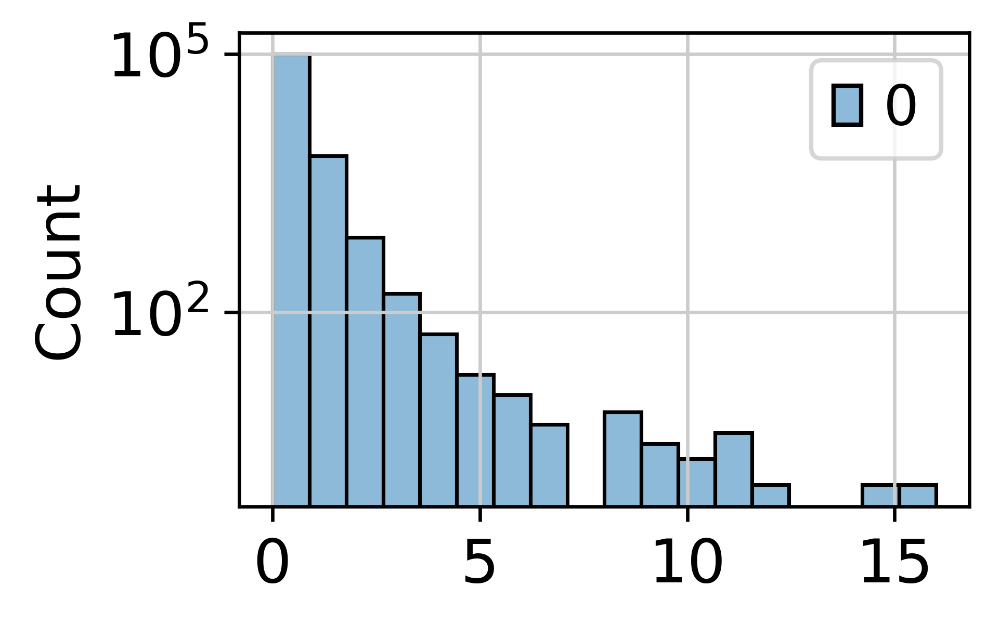

In [11]:
fig, ax = plt.subplots(figsize=(3, 2))
sns.histplot(germ_exons, ax=ax)
plt.yscale("log")

19


<Axes: ylabel='Count'>

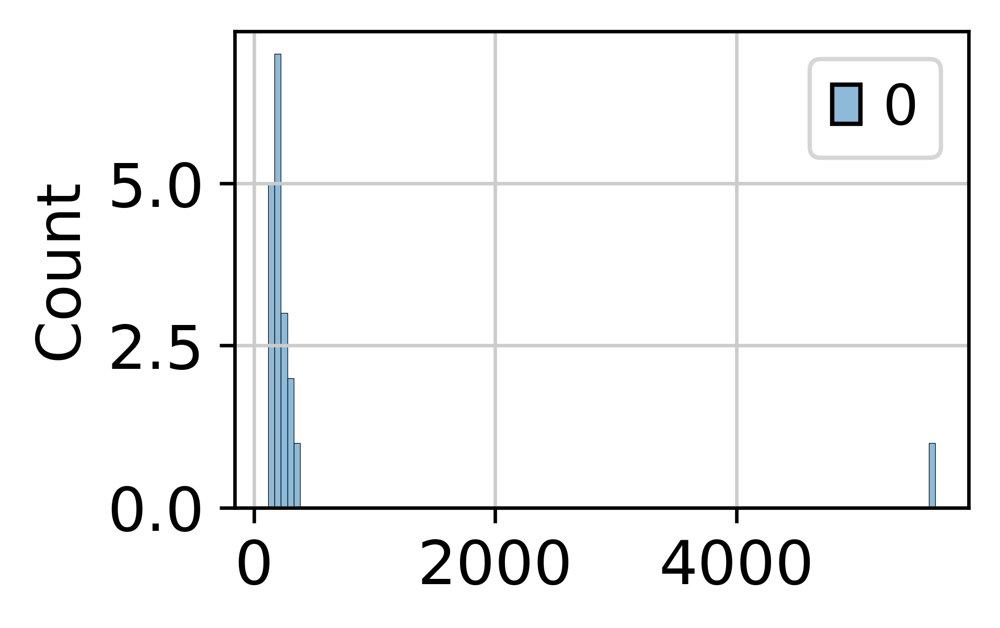

In [13]:
min_germ = 7
germ_coverage = (adata[germ_exons > min_germ, :].layers["exon"] + adata[germ_exons > min_germ, :].layers["spanning"]).sum(axis=1)
print((germ_exons > min_germ).sum())

fig, ax = plt.subplots(figsize=(3, 2))
sns.histplot(germ_coverage, ax=ax)
# plt.yscale("log")

In [7]:
adata.var["n_cells"] = ((adata.layers["exon"] + adata.layers["spanning"]) > 0).sum(axis=0).A1
adata.obs["nUMI_per_cell"] = (adata.layers["exon"] + adata.layers["spanning"]).sum(axis=1)
adata.obs["ngenes_per_cell"] = ((adata.layers["exon"] + adata.layers["spanning"]) > 0).sum(axis=1)

In [9]:
adata.obs.lib.value_counts()

lib
S12_2_1       28317
S12_2_2       27761
S12_2_3       22432
SRR7061432     4936
SRR7061431     4603
SRR7061433     4145
Name: count, dtype: int64

In [10]:
ncells = 3
nUMI_per_cell = 150
ngenes_per_cell = 100

adata = adata[:, adata.var.n_cells >= ncells]
adata = adata[(adata.obs.nUMI_per_cell > nUMI_per_cell) & (adata.obs.ngenes_per_cell > ngenes_per_cell), :]

In [11]:
adata.obs.lib.value_counts()

lib
S12_2_1       28317
S12_2_2       27761
S12_2_3       22432
SRR7061432     4936
SRR7061431     4603
SRR7061433     4145
Name: count, dtype: int64

In [12]:
adata.obs_names_make_unique()

In [44]:
# adata = adata.raw.to_adata()

In [45]:
sc.experimental.pp.recipe_pearson_residuals(adata, n_top_genes=3000, theta=10, batch_key="Library_name", n_comps=30)

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'highly_variable_nbatches', int vector (adata.var)
    'highly_variable_intersection', boolean vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'residual_variances', float vector (adata.var)
computing analytic Pearson residuals on adata.X
    finished (0:00:03)
computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:06)


In [46]:
adata.raw = adata.copy()

In [47]:
sc.pp.normalize_total(adata, target_sum=1e3)
sc.pp.log1p(adata, )
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=20)
sc.tl.umap(adata)

normalizing counts per cell
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:33)


In [65]:
res = 1
cur_leiden = f"leiden_{res}"
# sc.tl.leiden(adata, resolution=res, key_added=cur_leiden)

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


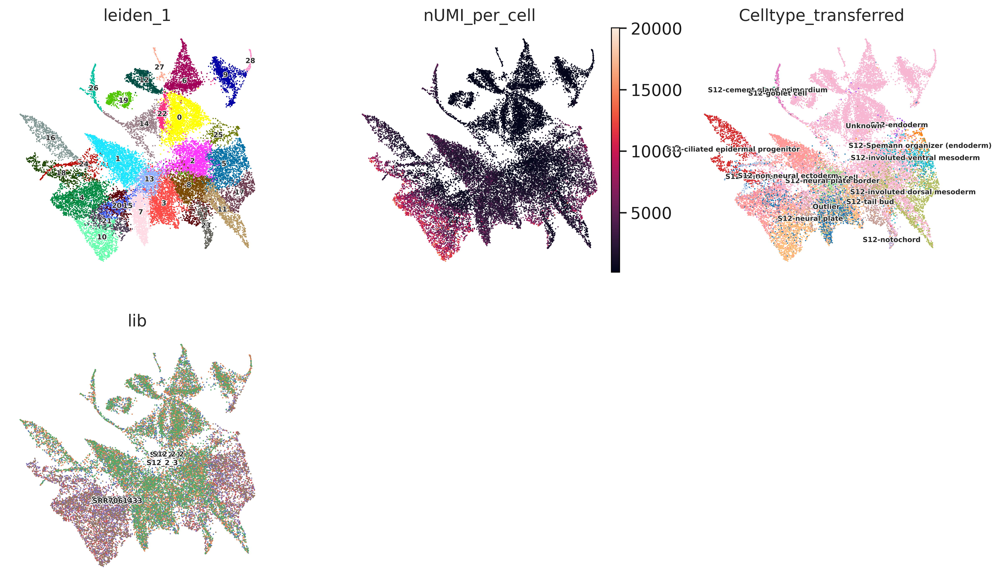

In [66]:
sc.set_figure_params(dpi=200)
sc.pl.umap(
    adata,
    color=[cur_leiden, "nUMI_per_cell", "Celltype_transferred", "lib"],
    legend_loc="on data",
    legend_fontsize=6,
    legend_fontoutline=1,
    frameon=False,
    ncols=3,
)

# Cell type prediction

In [50]:
infer_groups = [unlabeled, ]
adata_test = adata 
adata_train = adata[~adata.obs[train_target].isin(infer_groups)]

In [52]:
adata.var["gene_id"] = adata.var_names.to_series()

In [53]:
p_adj = 0.05
method = "wilcoxon"
pct = 0.2
n_top = 30
use_raw = False
logfoldchange = 0
labels = adata_train.obs[train_target].cat.categories
gene_symbols = "gene_id"

de_params = {
    "log_foldchange": logfoldchange,
    "p_adj": p_adj,
    "method": method,
    "n_top": n_top,
    "pct": pct
}

celltype_collection = get_celltype_collection(adata_train, train_target, de_params)
celltype_gsea_results = run_GSEA(adata_test, cur_leiden, de_params, gene_symbols, celltype_collection)

celltype_by_cluster = {
    cluster: celltype_gsea_results[cluster].sort_values(["score"]).iloc[-1,:] \
        for cluster in adata_test.obs[cur_leiden].cat.categories
    }

predicted_best = [celltype_by_cluster[cluster].name for cluster in adata_test.obs[cur_leiden]]

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:25)
involuted dorsal mesoderm 30
involuted ventral mesoderm 30
tail bud 30
ciliated epidermal progenitor 30
non-neural ectoderm 30
Spemann organizer (endoderm) 30
neural plate 30
ionocyte 30
goblet cell 30
cement gland primordium 30
endoderm 30
notochord 30
neural plate border 30
ranking genes
    finished: added to `.uns['leiden_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray t

### celltype scores by cluster:

In [54]:
celltypes_by_cluster = {
    celltype: {
        cluster: celltype_gsea_results[cluster].loc[celltype, "norm"] \
        for cluster in adata_test.obs[cur_leiden].cat.categories
    }
    for celltype in celltype_collection.geneset.unique()
    }

for celltype, cluster_scores in celltypes_by_cluster.items():
    adata.obs[celltype] = [cluster_scores[cluster] for cluster in adata.obs[cur_leiden]]

### celltype best by cluster:

In [55]:
inferred_target = "Celltype_by_cluster"

In [56]:
adata.obs[inferred_target] = predicted_best
adata.obs[inferred_target] = adata.obs[inferred_target].astype("category")

In [57]:
crosstab = pd.crosstab(adata.obs[celltype_barcode], adata.obs[inferred_target])
crosstab = crosstab.div(crosstab.sum(axis=1), axis=0)

In [58]:
sc.tl.dendrogram(adata, groupby=celltype_barcode, use_rep="X_pca")
row_linkage = adata.uns[f"dendrogram_{celltype_barcode}"]["linkage"]

sc.tl.dendrogram(adata, groupby=inferred_target, use_rep="X_pca")
column_linkage = adata.uns[f"dendrogram_{inferred_target}"]["linkage"]

Storing dendrogram info using `.uns['dendrogram_Celltype_barcode']`
Storing dendrogram info using `.uns['dendrogram_Celltype_by_cluster']`


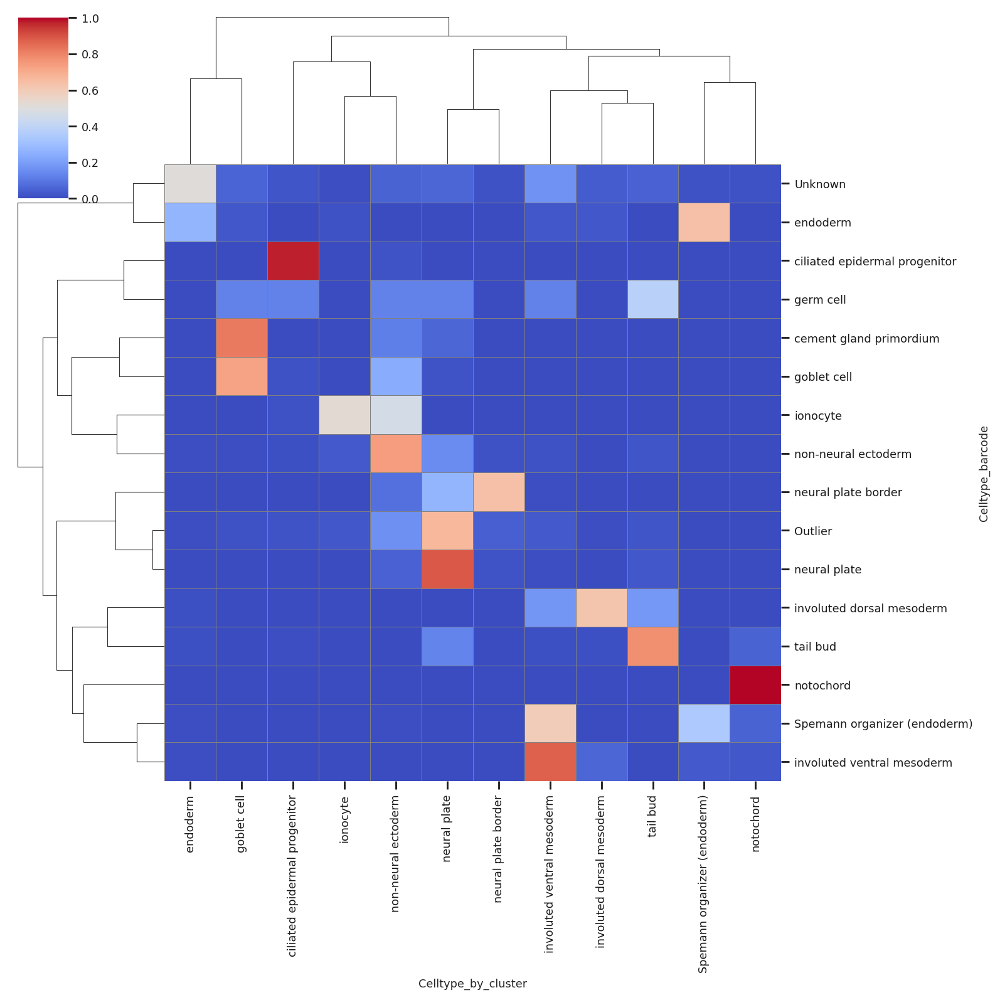

In [59]:
with sns.axes_style("ticks"):
    sc.set_figure_params(scanpy=True, fontsize=8)
    # fig, ax = plt.subplots(figsize=(8, 8))
    # g = sns.heatmap(
    g = sns.clustermap(
        crosstab,
        cmap="coolwarm",
        yticklabels=adata.obs[celltype_barcode].cat.categories,
        xticklabels=adata.obs[inferred_target].cat.categories,
        row_linkage=row_linkage,
        col_linkage=column_linkage,
        # ax=ax,
        linewidths=.3,
    #     row_cluster=False,
        linecolor='grey',
    #     square=True,
        # cbar_pos=(0.05, 0.87, 0.025, 0.1)
    #     cbar=False,
    )

In [60]:
abundance_table = pd.concat(
    [
        adata_train.obs[train_target].value_counts(),
        adata.obs[inferred_target].value_counts()
    ],
    axis=1
)
abundance_table.columns = [train_target, inferred_target]
abundance_table = abundance_table.fillna(0).astype(int)
abundance_table

,Celltype_transferred_short,Celltype_by_cluster
non-neural ectoderm,3461,3853
neural plate,2335,4884
involuted dorsal mesoderm,1512,1489
tail bud,978,1868
ciliated epidermal progenitor,933,1265
neural plate border,690,803
involuted ventral mesoderm,552,3243
goblet cell,278,1019
Spemann organizer (endoderm),228,300
ionocyte,164,310


In [61]:
abundance_table.sum(axis=0)

Celltype_transferred_short    11342
Celltype_by_cluster           26048
dtype: int64

# Leiden cluster annotation with Briggs DE gene markers

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


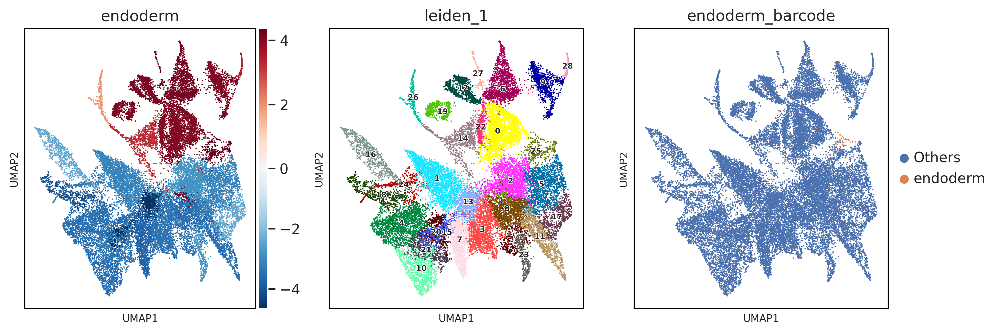

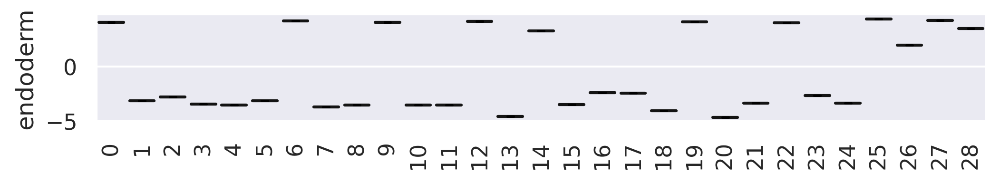

In [70]:
sc.set_figure_params(dpi=150, scanpy=True, fontsize=8)
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
ct = f'endoderm'
ct_barcode = ct + "_barcode"

adata.obs[ct_barcode] = adata.obs[celltype_barcode] == ct
adata.obs.loc[adata.obs[ct_barcode], ct_barcode] = ct
adata.obs.loc[~adata.obs[ct_barcode].astype(bool), ct_barcode] = "Others"

sns.set(font_scale = 1)
sc.pl.umap(
    adata, color=ct, cmap='RdBu_r', vcenter=0, legend_loc="on data", legend_fontsize=6,
    legend_fontoutline=1, ax=axs[0], show=False)

sc.pl.umap(
    adata, color=cur_leiden, legend_loc="on data", legend_fontsize=6,
    legend_fontoutline=1, ax=axs[1], show=False)

sc.pl.umap(
    adata, color=ct_barcode, ax=axs[2])

fig, ax = plt.subplots(figsize=(8, 1))
# sns.set(font_scale = 0.3)
ax = sc.pl.violin(adata, keys=[ct], groupby=cur_leiden, rotation=90, ax=ax)

In [ ]:
sc.set_figure_params(dpi=150, scanpy=True)

sc.pl.umap(
    adata,
    color=["Celltype_transferred", train_target,  inferred_target], 
    frameon=False,
)

# Checkpoint

In [31]:
adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")
adata.write(adata_fp)

In [15]:
# # restore 
# adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")
# adata = sc.read_h5ad(adata_fp)

inferred_target = "Celltype_by_cluster"
train_target_long = "Celltype_transferred"
train_target = f"{train_target_long}_short"
gene_symbols = "gene_id"

adata.uns['log1p']['base'] = None

In [5]:
adata

AnnData object with n_obs × n_vars = 92194 × 23046
    obs: 'lib', 'nUMI_per_cell', 'ngenes_per_cell', 'inDrops_version', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'cell_barcode', 'cell_barcode_v', 'Library_name', 'barcodes_unique', 'Celltype_transferred', 'Celltype_known', 'Celltype_transferred_short', 'Celltype_barcode', 'leiden_2', 'involuted dorsal mesoderm', 'involuted ventral mesoderm', 'neural plate', 'tail bud', 'non-neural ectoderm', 'ionocyte', 'ciliated epidermal progenitor', 'Spemann organizer (endoderm)', 'endoderm', 'goblet cell', 'cement gland primordium', 'notochord', 'neural plate border', 'Celltype_by_cluster', 'endoderm_barcode'
    var: 'gene_name', 'human_id', 'human_name', '

# Assessment of annotation of clusters
- celltype entropy -> undetermined cluster
- number of strong marker genes ~ cluster goodness
- fraction of celltype max -> subtype?

In [ ]:
# res = 2
# cur_leiden = f"leiden_{res}"
# sc.tl.leiden(adata, resolution=res, key_added=cur_leiden)
sc.set_figure_params(dpi=200)
sc.pl.umap(
    adata,
    color=cur_leiden,
    legend_loc="on data",
    legend_fontsize=6,
    legend_fontoutline=1,
    frameon=False,
)

In [71]:
celltypes_vs_clusters_unnorm = pd.crosstab(
    adata.obs[inferred_target],
    adata.obs[cur_leiden],
    dropna=False
)
celltypes_vs_clusters_by_celltype = celltypes_vs_clusters_unnorm.values / celltypes_vs_clusters_unnorm.values.sum(axis=1, keepdims=True)
celltypes_vs_clusters_by_cluster = celltypes_vs_clusters_unnorm.values / celltypes_vs_clusters_unnorm.values.sum(axis=0, keepdims=True)

In [72]:
method = "wilcoxon"

sc.tl.rank_genes_groups(adata, cur_leiden, method=method, use_raw=False, key_added=cur_leiden, pts=True, gene_symbols=gene_symbols)

ranking genes
    finished: added to `.uns['leiden_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:02:14)


In [73]:
cluster_marker_genes = {}

logfoldchange = 2
p_adj = 0.05
pct = 0.5

for cluster in adata.obs[cur_leiden].cat.categories:
    mg_df = sc.get.rank_genes_groups_df(adata, group=cluster, key=cur_leiden)
    mg_df = mg_df.loc[(mg_df.logfoldchanges > logfoldchange) & (mg_df.pvals_adj < p_adj) & (mg_df.pct_nz_group > pct)]
    cluster_marker_genes[cluster] = mg_df

In [74]:
cluster2cell_type = pd.DataFrame(
    {
        "cluster": adata.obs[cur_leiden].cat.categories,
        "celltype_max":  adata.obs[inferred_target].cat.categories[celltypes_vs_clusters_by_cluster.argmax(axis=0)],
        "celltype_max_frac": celltypes_vs_clusters_by_celltype[celltypes_vs_clusters_by_cluster.argmax(axis=0)].diagonal(),
        "celltype_entropy": scipy.stats.entropy(celltypes_vs_clusters_by_cluster, axis=0),
        f"mg_num_{logfoldchange}_{p_adj}_{pct}": [cluster_marker_genes[cluster].shape[0] for cluster in adata.obs[cur_leiden].cat.categories]
    }
)

In [75]:
with pd.option_context('display.max_rows', None,
                       'display.max_columns', None,
                       'display.precision', 3,
                       ):
    display(cluster2cell_type.sort_values("celltype_max_frac"))

,cluster,celltype_max,celltype_max_frac,celltype_entropy,mg_num_2_0.05_0.5
27,27,endoderm,0.013,0.0,5
22,22,endoderm,0.065,0.0,4
19,19,endoderm,0.081,0.0,4
21,21,neural plate,0.103,0.0,10
20,20,neural plate,0.109,0.0,1
12,12,endoderm,0.132,0.0,6
9,9,endoderm,0.158,0.0,5
10,10,neural plate,0.202,0.0,27
6,6,endoderm,0.208,0.0,8
7,7,neural plate,0.253,0.0,17


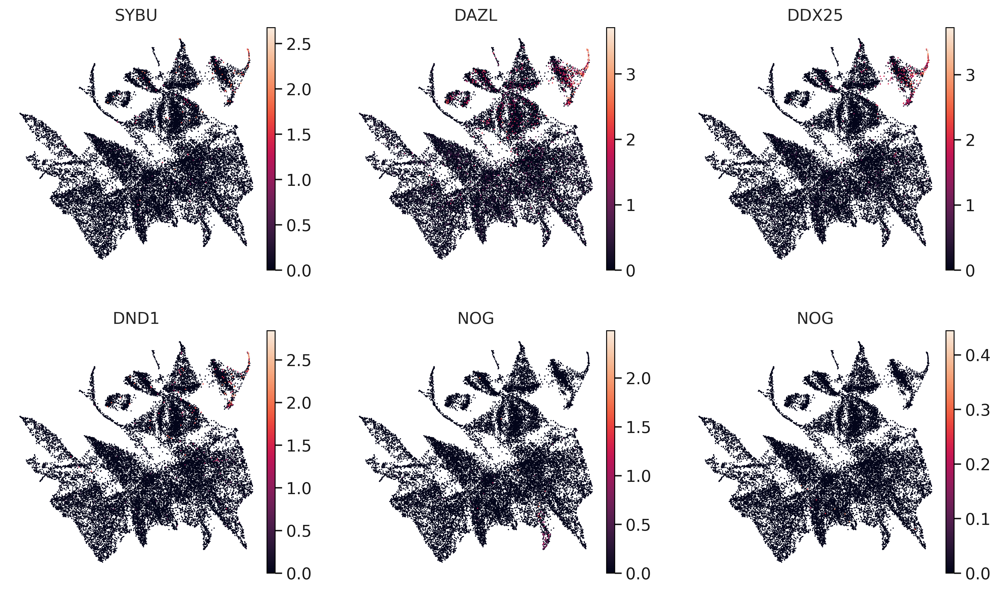

In [67]:
genes = ["ddx25", "dazl", "sybu", "dnd1", "nog", "nog2", "chga", "sox17a", "sox17b.2", "sox17b.1", "chrd.1"]
color = adata_ref.var_names[adata_ref.var["gene_name"].isin(genes)]
names = adata_ref.var.loc[adata_ref.var["gene_name"].isin(genes), "gene_name"].astype("str") + "|" \
    + adata_ref.var.loc[adata_ref.var["gene_name"].isin(genes), "human_name"].astype("str")
sc.pl.umap(adata_ref, color=color, frameon=False, ncols=3, use_raw=False, title=names)

# Cluster explore

In [ ]:
# sc.tl.rank_genes_groups(
#     adata, cur_leiden, method='wilcoxon', use_raw=False, gene_symbols=gene_symbols, key_added=cur_leiden
# )

In [25]:
groups = ["2", ]
reference = "13"
key_added = f"{','.join(groups)} vs {reference}"

In [51]:
sc.tl.rank_genes_groups(
    adata, cur_leiden, method='wilcoxon', use_raw=False,
    groups=groups,
    reference=reference,
    key_added=key_added
)

ranking genes
    finished: added to `.uns['16 vs 13']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [77]:
gene_name = "gene_name_display"
adata.var[gene_name] = adata.var.gene_id.astype("str")
idx = ~adata.var.gene_name.isna()
adata.var.loc[idx, gene_name] += "|" + adata.var.loc[idx, "gene_name"].astype("str")
idx = ~adata.var.human_name.isna()
adata.var.loc[idx, gene_name] += "|" + adata.var.loc[idx, "human_name"].astype("str")

adata.var[gene_name]

XBXT10g000001      XBXT10g000001|nsfl1c|NSFL1C
XBXT10g000002        XBXT10g000002|clul1|CLUL1
XBXT10g000003        XBXT10g000003|vwc2l|VWC2L
XBXT10g000004    XBXT10g000004|slc47a1|SLC47A1
XBXT10g000005        XBXT10g000005|ikbkg|IKBKG
                             ...              
XBXT10g029565       XBXT10g029565|LOC116412448
XBXT10g029569       XBXT10g029569|LOC105945488
XBXT10g029570    XBXT10g029570|crygdl.43|CRYGB
XBXT10g029572          XBXT10g029572|trnae-cuc
XBXT10g029573       XBXT10g029573|LOC105947954
Name: gene_name_display, Length: 23046, dtype: object

In [32]:
gene_symbols = gene_name
marker_genes = sc.get.rank_genes_groups_df(adata, group=groups, gene_symbols=gene_symbols, key=cur_leiden)

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


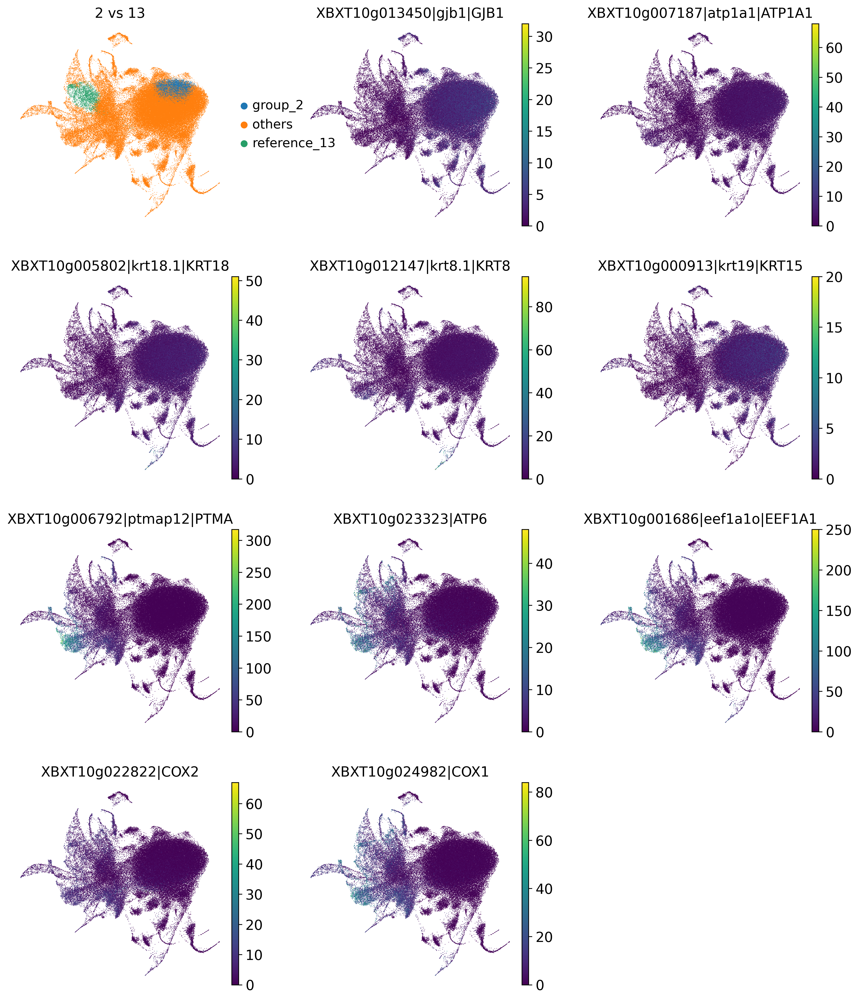

In [33]:
sc.set_figure_params(dpi=150)
ntop = nbottom = 5
use_raw = True

adata.obs["cur_cluster"] = "others"

marker_genes_top = []
marker_genes_bottom = []
marker_genes_top_symbols = []
marker_genes_bottom_symbols = []

if len(groups) > 1:
    for group in groups:
        adata.obs.loc[adata.obs[cur_leiden] == group, "cur_cluster"] = f"group_{group}"
        marker_genes_top += list(marker_genes.loc[marker_genes.group == group, "names"][:ntop])
        marker_genes_top_symbols += list(marker_genes.loc[marker_genes.group == group, gene_symbols][:ntop])
        marker_genes_bottom += list(marker_genes.loc[marker_genes.group == group, "names"][-nbottom:])
        marker_genes_bottom_symbols += list(marker_genes.loc[marker_genes.group == group, gene_symbols][-nbottom:])
else:
    adata.obs.loc[adata.obs[cur_leiden] == groups[0], "cur_cluster"] = f"group_{groups[0]}"
    marker_genes_top += list(marker_genes["names"][:ntop])
    marker_genes_top_symbols += list(marker_genes[gene_symbols][:ntop])
    marker_genes_bottom += list(marker_genes["names"][-nbottom:])
    marker_genes_bottom_symbols += list(marker_genes[gene_symbols][-nbottom:])
    
adata.obs.loc[adata.obs[cur_leiden] == reference, "cur_cluster"] = f"reference_{reference}"

    
colors = ["cur_cluster"] + marker_genes_top + marker_genes_bottom 
titles = [key_added] + marker_genes_top_symbols + marker_genes_bottom_symbols

sc.pl.umap(
    adata,
    color=colors,
    title=titles,
    frameon=False,
    ncols=3,
    use_raw=use_raw
#     vmax=[30, 10, 40, 20]
)

In [51]:
adata.obs.loc[adata.obs[cur_leiden].isin(groups+[reference,]), [cur_leiden, celltype_barcode]].value_counts().sort_index()

leiden_3  Celltype_barcode                 
19        S18-chordal neural crest              80
          S18-cranial neural crest             276
          Unknown                                2
53        Outlier                                1
          S18-anterior placodal area             1
          S18-chordal neural crest               5
          S18-cranial neural crest              79
          S18-endoderm / foregut primordium      1
          Unknown                                4
Name: count, dtype: int64

In [ ]:
def find_genes(adata, names_column, gene_names):
    id_2_name = {}
    
    for gene in gene_names:
        genes = adata.var.loc[adata.var[names_column].str.contains(gene, case=False, na=False), :]
        for i, gene in genes.iterrows():
            id_2_name[i] = gene[names_column]
    
    return id_2_name

In [93]:
gene_symbols = gene_name
cluster = "27"
marker_genes = sc.get.rank_genes_groups_df(adata, group=cluster, gene_symbols=gene_symbols, key=cur_leiden)

In [95]:
bad_clusters = [str(i) for i in [0, 6, 9, 12, 14, 19, 22, 27]] #, 1, 2, 3, 4, 5, 7, 8, 9, 10, 14, 17, 18, 21, 22, 26, 28, 33, 39]]

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


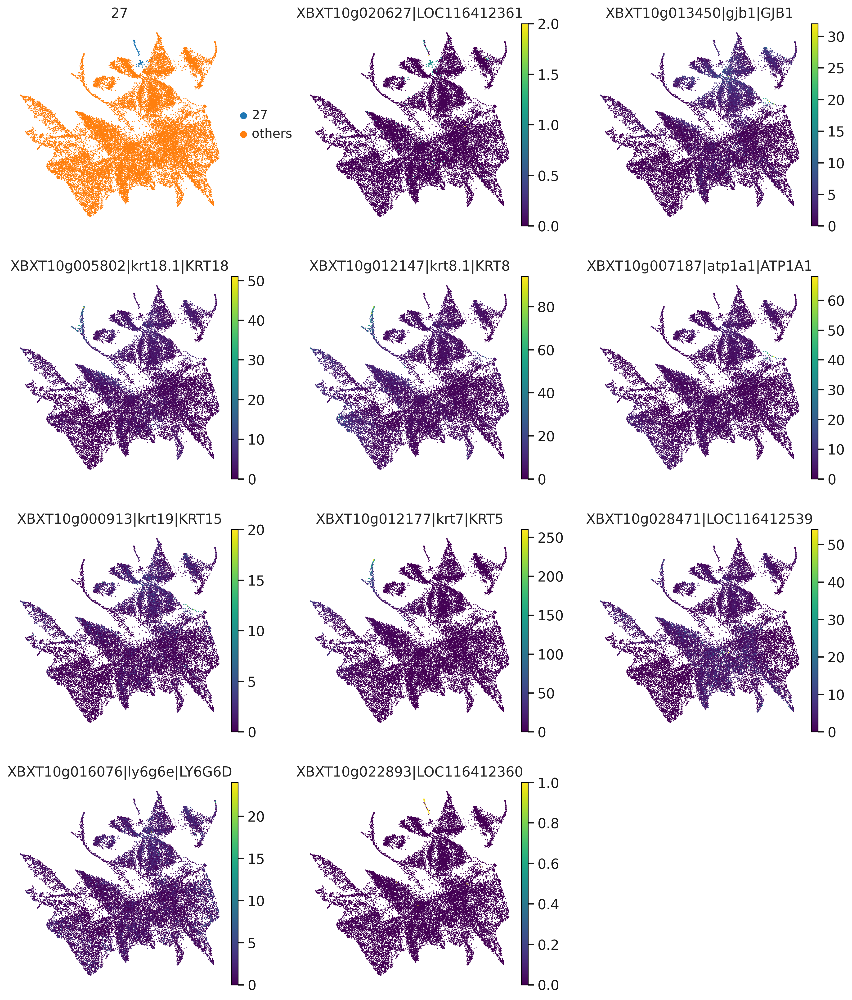

In [94]:
%matplotlib inline
sc.set_figure_params(dpi=150, scanpy=True)
num_genes = 10

adata.obs["cur_cluster"] = "others"
adata.obs.loc[adata.obs[cur_leiden] == cluster, "cur_cluster"] = cluster
colors = ["cur_cluster"] + list(marker_genes.iloc[0:num_genes, 0])
titles = [cluster] + list(marker_genes[gene_symbols].iloc[0:num_genes])

sc.pl.umap(
    adata,
    color=colors,
    title=titles,
    frameon=False,
    ncols=3,
    use_raw=True,
    cmap='viridis',
)

## GSEA

In [52]:
import decoupler
msigdb = decoupler.get_resource("MSigDB")
msigdb.collection.unique()
cell_type_signatures = msigdb.query("collection == 'cell_type_signatures'").copy()
go_molecular_function = msigdb.query("collection == 'go_molecular_function'").copy()
reactome = msigdb.query("collection == 'reactome_pathways'").copy()

In [66]:
cur_collection = cell_type_signatures
cur_collection.drop_duplicates(["genesymbol", "geneset"], inplace=True)
cur_collection

,genesymbol,collection,geneset
31,MAFF,cell_type_signatures,DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_RESPIR...
41,MAFF,cell_type_signatures,FAN_OVARY_CL9_PUTATIVE_APOPTOTIC_ENDOTHELIAL_CELL
89,MAFF,cell_type_signatures,FAN_OVARY_CL17_PUTATIVE_APOPTOTIC_SMOOTH_MUSCL...
95,MAFF,cell_type_signatures,ZHENG_CORD_BLOOD_C5_SIMILAR_TO_HSC_C6_PUTATIVE...
97,MAFF,cell_type_signatures,HAY_BONE_MARROW_NK_CELLS
...,...,...,...
3837652,KDM5D,cell_type_signatures,HE_LIM_SUN_FETAL_LUNG_C7_PROLIFERATING_SCHWANN...
3837919,PRSS3P2,cell_type_signatures,MURARO_PANCREAS_ACINAR_CELL
3838132,GSTT1,cell_type_signatures,CUI_DEVELOPING_HEART_COMPACT_VENTRICULAR_CARDI...
3838235,GSTT1,cell_type_signatures,FAN_EMBRYONIC_CTX_BIG_GROUPS_CAJAL_RETZIUS


In [67]:
geneset_size = cur_collection.groupby("geneset").size()
cur_collection_genesets = geneset_size.index[(geneset_size > 5) & (geneset_size < 500)]

In [68]:
t_stats = (
    # Get dataframe of DE results for condition vs. rest
    sc.get.rank_genes_groups_df(adata, cluster, key=cur_leiden, gene_symbols="human_gene_symbol")
    # Subset to highly variable genes
    .set_index("human_gene_symbol")
#     .loc[adata_kotov_s22.var["highly_variable"]]
    # Sort by absolute score
    .sort_values("scores", key=np.abs, ascending=False)
    # Format for decoupler
    [["scores"]]
    .rename_axis([cur_leiden], axis=1)
)
t_stats

leiden_1,scores
human_gene_symbol,
SHOX,8.065987
IGF1R,8.064615
KIAA0825,8.043684
MACF1,8.026241
ITFG2,7.845480
...,...
HTR2B,-0.000798
RAB18,-0.000434
RPS13,-0.000399


In [69]:
scores, norm, pvals = decoupler.run_gsea(
    t_stats.T,
    cur_collection[cur_collection["geneset"].isin(cur_collection_genesets)],
    source="geneset",
    target="genesymbol"
)

gsea_results = (
    pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
    .droplevel(level=1, axis=1)
    .sort_values("pval")
)

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/seaborn/_core/plot.py:941: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.savefig(buffer, dpi=dpi * 2, format="png", bbox_inches="tight")


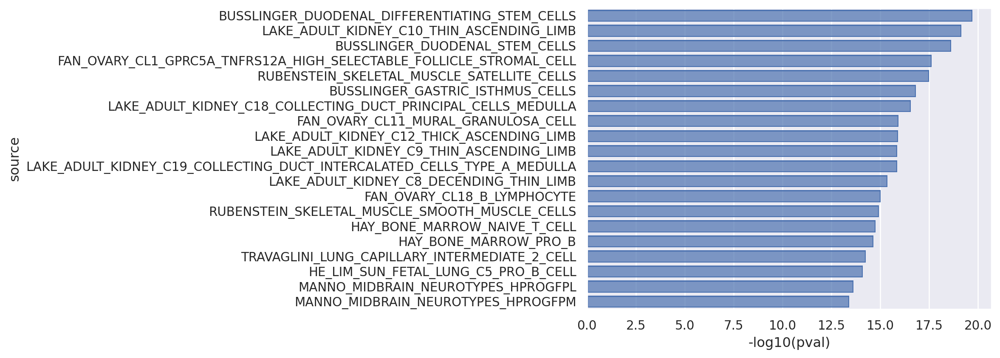

In [70]:
(
    so.Plot(
        data=(
            gsea_results.loc[(gsea_results.pval < 0.05) & (gsea_results.score > 0), :].sort_values("pval", ascending=True).head(20).assign(
                **{"-log10(pval)": lambda x: -np.log10(x["pval"])}
            )
        ),
        x="-log10(pval)",
        y="source",
    ).add(so.Bar())
)

In [71]:
gsea_results.loc[(gsea_results.pval < 0.05) & (gsea_results.score > 0), :].sort_values("score", ascending=False).head(40)

,score,norm,pval
source,,,
GAO_LARGE_INTESTINE_ADULT_CF_GOBLET_CELL_SUBTYPE_1,0.879553,2.089008,3.670697e-02
BUSSLINGER_DUODENAL_MX_CELLS,0.843716,2.030245,4.233161e-02
HAY_BONE_MARROW_CD34_POS_EO_B_MAST,0.777737,2.041155,4.123539e-02
MENON_FETAL_KIDNEY_0_CAP_MESENCHYME_CELLS,0.775081,5.203659,1.954029e-07
BUSSLINGER_GASTRIC_PPP1R1B_POSITIVE_CELLS,0.765894,6.320756,2.602860e-10
BUSSLINGER_GASTRIC_LYZ_POSITIVE_CELLS,0.765007,6.034972,1.589901e-09
HE_LIM_SUN_FETAL_LUNG_C3_DEFINITIVE_ERYTHROCYTE,0.751773,1.977369,4.799998e-02
MANNO_MIDBRAIN_NEUROTYPES_BASAL,0.750690,5.748302,9.014413e-09
DESCARTES_MAIN_FETAL_UNIPOLAR_BRUSH_CELLS,0.750314,2.094050,3.625549e-02


# Discard some clusters

In [96]:
adata.shape

(26048, 23046)

In [97]:
# bad_clusters = ["0", ]
adata = adata[~adata.obs[cur_leiden].isin(bad_clusters), :]
# acts = acts[~acts.obs[cur_leiden].isin(bad_clusters), :]

In [98]:
adata.shape

(18708, 23046)

# Reannotation

In [41]:
train_target, inferred_target

('Celltype_transferred_short', 'Celltype_by_cluster')

In [99]:
cluster_celltype = {
    # "45": "germ cell",
    # "25": "germ cell"
    "28": "germ cell",
    "26": "cement gland primordium",
}

adata.obs[inferred_target] = adata.obs[inferred_target].astype("str")

for cluster, cell_type in cluster_celltype.items():
    adata.obs.loc[adata.obs[cur_leiden] == cluster, inferred_target] = cell_type
    
adata.obs[inferred_target] = adata.obs[inferred_target].astype("category")

/tmp/ipykernel_19772/2478644636.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[inferred_target] = adata.obs[inferred_target].astype("str")


In [100]:
adata.obs[inferred_target].value_counts()

Celltype_by_cluster
neural plate                     4884
non-neural ectoderm              3853
involuted ventral mesoderm       3243
tail bud                         1868
involuted dorsal mesoderm        1489
ciliated epidermal progenitor    1265
neural plate border               803
notochord                         358
ionocyte                          310
Spemann organizer (endoderm)      300
cement gland primordium           251
germ cell                          84
Name: count, dtype: int64

# Checkpoint 2

In [101]:
adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")
adata.write(adata_fp)